<a href="https://colab.research.google.com/github/magewade/lenta-ru-news-project/blob/main/Project_Lentaru_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Проект по анализу данных с сайта Lenta.ru

## Часть 1.1
### Реализация парсера

In [ ]:
%%capture
!pip install selenium

In [ ]:
import re
import time
import datetime
import pandas as pd
from tqdm import tqdm
from bs4 import BeautifulSoup
from selenium import webdriver
from dataclasses import dataclass
from selenium.webdriver.common.by import By

In [ ]:
SLEEP = 2
DEPTH = 500
BASE_URL = 'https://lenta.ru/'

In [ ]:
# set webdriver params before defining get_topics
chrome_options = webdriver.ChromeOptions()
chrome_options.add_argument('headless')
chrome_options.add_argument('no-sandbox')
chrome_options.add_argument('disable-dev-shm-usage')
driver = webdriver.Chrome(options=chrome_options)
driver.set_page_load_timeout(300)

Захотела сделать динамический парсинг топиков

In [ ]:
def get_topics():
    """Получить список рубрик с сайта lenta.ru"""
    driver.get(BASE_URL)
    time.sleep(SLEEP)

    # Кликнуть на бургер-меню
    menu_button = driver.find_element(By.CSS_SELECTOR, ".header__burger.js-burger-to-menu")
    menu_button.click()
    time.sleep(SLEEP)

    # Извлекаем HTML-страницу
    html = driver.page_source
    soup = BeautifulSoup(html, "html.parser")

    # Ищем все ссылки на рубрики в меню
    topics = soup.select("a.menu__nav-link._is-extra")  # Класс рубрик
    return [topic['href'].strip("/") for topic in topics if topic['href'].startswith("/rubrics")]

In [ ]:
TOPICS = get_topics()

In [ ]:
TOPICS

['rubrics/russia',
 'rubrics/world',
 'rubrics/ussr',
 'rubrics/economics',
 'rubrics/forces',
 'rubrics/science',
 'rubrics/culture',
 'rubrics/sport',
 'rubrics/media',
 'rubrics/style',
 'rubrics/travel',
 'rubrics/life',
 'rubrics/realty',
 'rubrics/wellness',
 'rubrics/pobeda80']

In [ ]:
@dataclass
class Article:
    id: str = None
    url: str = None
    title: str = None
    subtitle: str = None
    author: str = None
    content: str = None
    date: str = None
    tag: int = None
    topic: int = None

In [ ]:
from tqdm.notebook import tqdm
import csv
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.webdriver.common.by import By
from selenium.webdriver.common.action_chains import ActionChains


def save_to_csv(data, filename="articles.csv"):
    """Сохранить данные в CSV файл"""
    headers = ['url', 'title', 'subtitle', 'author', 'content', 'date', 'tag', 'topic']
    with open(filename, mode='w', newline='', encoding='utf-8') as file:
        writer = csv.writer(file)
        writer.writerow(headers)
        writer.writerows(data)

def parse_articles_by_topic(goodnews_tumbler=False):
    """Получить статьи по всем рубрикам и сохранить в CSV"""
    all_articles = []

    if goodnews_tumbler:
        try:
            # Находим checkbox по классу
            checkbox = driver.find_element(By.CSS_SELECTOR, '.goodnews__checkbox.js-goodnews-tumbler')
            driver.execute_script("arguments[0].scrollIntoView(true);", checkbox)
            time.sleep(SLEEP)

            # Если он не выбран, кликаем
            if not checkbox.is_selected():
                print("Кликаем на checkbox 'Лента добра'")
                checkbox.click()

            time.sleep(SLEEP)
        except Exception as e:
            tqdm.write(f"Не удалось кликнуть на чекбокс 'Лента добра': {e}")


    for topic in tqdm(TOPICS, desc="Парсинг рубрик"):
        try:
            url = BASE_URL + topic
            driver.get(url)
            time.sleep(SLEEP)
            html = driver.page_source
            soup = BeautifulSoup(html, "html.parser")

            # Извлекаем список статей
            articles = soup.select('h3.card-mini__title')
            tqdm.write(f"\nНайдено {len(articles)} статей в рубрике {topic}")

            for article in tqdm(articles, desc=f"Обработка статей ({topic})", leave=False):
                try:
                    parent_link = article.find_parent('a')
                    if parent_link and 'href' in parent_link.attrs:
                        article_url = BASE_URL + parent_link['href']
                        article_data = parse_article(article_url, topic)
                        if article_data:
                            all_articles.append(article_data)
                except Exception as e:
                    tqdm.write(f"Ошибка при обработке статьи {article.text.strip()}: {e}")

        except Exception as e:
            tqdm.write(f"Ошибка при парсинге рубрики {topic}: {e}")

    # Сохранить в CSV
    tqdm.write("Сохраняю данные в CSV")
    save_to_csv(all_articles)

def parse_article(article_url, topic):
    """Извлечение данных из страницы статьи"""
    try:
        driver.get(article_url)
        time.sleep(SLEEP)
        html = driver.page_source
        soup = BeautifulSoup(html, "html.parser")

        # Заголовок
        title_elem = soup.find('span', {'class': 'topic-body__title'})
        title = title_elem.text.strip() if title_elem else None

        # Подзаголовок
        subtitle_elem = soup.find('div', {'class': 'topic-body__title-yandex'})
        subtitle = subtitle_elem.text.strip() if subtitle_elem else None

        # Автор
        author_elem_img = soup.find('img', {'class': 'topic-authors__photo'})
        author_elem_text = soup.find('span', {'class': 'topic-authors__name'})
        if author_elem_img and 'alt' in author_elem_img.attrs:
            author = author_elem_img['alt'].strip()
        elif author_elem_text:
            author = author_elem_text.text.strip()
        else:
            author = None

        # Содержание статьи
        content_elem = soup.find('div', {'class': 'topic-body__content'})
        if content_elem:
            paragraphs = content_elem.find_all('p', {'class': 'topic-body__content-text'})
            content = ' '.join(paragraph.text.strip() for paragraph in paragraphs)  # Берем всю статью
        else:
            content = None

        # Дата публикации
        date_elem = soup.find('a', {'class': 'topic-header__item topic-header__time'})
        date = date_elem.text.strip() if date_elem else None

        # Тема
        tag_elem = soup.find('a', {'class': 'rubric-header__link _active'})
        tag = tag_elem.text.strip() if tag_elem else topic

        # Вернуть данные статьи
        return [article_url, title, subtitle, author, content, date, tag, topic]

    except Exception as e:
        tqdm.write(f"Ошибка при парсинге статьи {article_url}: {e}")
        return None


Я там пыталась прописать тумблер для ленты добра, чтобы спарсить новости без риска получить экзистенциальный кризис, у меня один раз получилось, но там был тестовый вариант с ограничением на 10 новостей, а потом все сломалось, так что придется работать с недобрым датасетом :(

Но если есть идеи почему кнопка не жмакается, то дайте мне знать, пожалуйста (через click и через soap я тоже пробовала)

In [ ]:
# Запуск парсинга
print("Начало парсинга статей по темам.")
parse_articles_by_topic(goodnews_tumbler=False) # никакого праздника

# Закрытие драйвера
driver.quit()
print("Парсинг завершен.")

Начало парсинга статей по темам.


Парсинг рубрик:   0%|          | 0/15 [00:00<?, ?it/s]


Найдено 70 статей в рубрике rubrics/russia


Обработка статей (rubrics/russia):   0%|          | 0/70 [00:00<?, ?it/s]


Найдено 81 статей в рубрике rubrics/world


Обработка статей (rubrics/world):   0%|          | 0/81 [00:00<?, ?it/s]


Найдено 79 статей в рубрике rubrics/ussr


Обработка статей (rubrics/ussr):   0%|          | 0/79 [00:00<?, ?it/s]


Найдено 83 статей в рубрике rubrics/economics


Обработка статей (rubrics/economics):   0%|          | 0/83 [00:00<?, ?it/s]


Найдено 86 статей в рубрике rubrics/forces


Обработка статей (rubrics/forces):   0%|          | 0/86 [00:00<?, ?it/s]


Найдено 82 статей в рубрике rubrics/science


Обработка статей (rubrics/science):   0%|          | 0/82 [00:00<?, ?it/s]


Найдено 80 статей в рубрике rubrics/culture


Обработка статей (rubrics/culture):   0%|          | 0/80 [00:00<?, ?it/s]


Найдено 81 статей в рубрике rubrics/sport


Обработка статей (rubrics/sport):   0%|          | 0/81 [00:00<?, ?it/s]


Найдено 78 статей в рубрике rubrics/media


Обработка статей (rubrics/media):   0%|          | 0/78 [00:00<?, ?it/s]


Найдено 80 статей в рубрике rubrics/style


Обработка статей (rubrics/style):   0%|          | 0/80 [00:00<?, ?it/s]


Найдено 83 статей в рубрике rubrics/travel


Обработка статей (rubrics/travel):   0%|          | 0/83 [00:00<?, ?it/s]


Найдено 78 статей в рубрике rubrics/life


Обработка статей (rubrics/life):   0%|          | 0/78 [00:00<?, ?it/s]


Найдено 75 статей в рубрике rubrics/realty


Обработка статей (rubrics/realty):   0%|          | 0/75 [00:00<?, ?it/s]


Найдено 89 статей в рубрике rubrics/wellness


Обработка статей (rubrics/wellness):   0%|          | 0/89 [00:00<?, ?it/s]


Найдено 17 статей в рубрике rubrics/pobeda80


Обработка статей (rubrics/pobeda80):   0%|          | 0/17 [00:00<?, ?it/s]

Сохраняю данные в CSV
Парсинг завершен.


---

## Часть 1.2
### Первичный анализ данных

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import datetime
from wordcloud import WordCloud, STOPWORDS

import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")

sns.set(style="darkgrid")
%matplotlib inline

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
colors = [
    "#BF8709", "#EAC57D", "#E8B100", "#ECC424", "#FCE2AD",
    "#B9BBDE", "#807490", "#704643", "#523857", "#C9A1B0",
    "#536F01", "#7A942C", "#4E7850", "#A3B57E", "#ECE8D3"
]

sns.set_palette(sns.color_palette(colors))

In [ ]:
import warnings
warnings.filterwarnings("ignore")

Основные описательные статистики + визуальный анализ данных. Важно отметить интересные моменты в данных до проведения исследования:
- определить особенности выборки по результатам первичного анализ, удаление выбросов и т.д.
- отметить моменты, которые позволят до проведения расчетов и построения моделей, выдвинуть несколько гипотез/предположений о результатах следующих этапов и т.д.
---
- Распределение категорий
- Распределение времени новостей
- Распределение по длине заголовка
- Распределение по длине текста
- Ключевые слова по каждой из тематик

In [ ]:
df = pd.read_csv('/content/articles.csv', index_col=None)

In [ ]:
df.head()

,url,title,subtitle,author,content,date,tag,topic
0,https://lenta.ru//news/2025/01/28/moskvich-pot...,Москвич потерял сознание на улице и остался бе...,На западе Москвы мужчина упал на улице и остал...,Анна Щербакова,На западе Москвы мужчина потерял сознание и уп...,"13:53, 28 января 2025",Общество,rubrics/russia
1,https://lenta.ru//news/2025/01/28/gosduma-razr...,Госдума разрешила оформлять ДТП по-новому,"Госдума приняла закон, разрешающий оформлять Д...",Константин Лысяков,Госдума сразу во втором и третьем чтениях прин...,"13:41, 28 января 2025",Политика,rubrics/russia
2,https://lenta.ru//news/2025/01/28/pod-moskvoy-...,Под Москвой бойца СВО с медалями не пустили в ...,"В Подмосковье бойца СВО не пустили в бар, сосл...",Алан Босиков,В Подмосковье участника специальной военной оп...,"13:37, 28 января 2025",Общество,rubrics/russia
3,https://lenta.ru//news/2025/01/28/v-rossii-vys...,В России высказались о плане Зеленского погово...,Депутат Журова: План Зеленского поговорить с Т...,Варвара Кошечкина,План президента Украины Владимира Зеленского п...,"13:27, 28 января 2025",Политика,rubrics/russia
4,https://lenta.ru//news/2025/01/28/v-krymu-povy...,В Крыму повысили выплату за участие в СВО,В Крыму увеличили размер выплаты для новобранц...,Алан Босиков,В Крыму повысили выплату новобранцам специальн...,"13:21, 28 января 2025",Общество,rubrics/russia


In [ ]:
# Размер датасета
df.shape

(1142, 8)

In [ ]:
df.isna().sum()

,0
url,0
title,0
subtitle,97
author,2
content,0
date,0
tag,0
topic,0


У нас есть пропуски в подзаголовках и авторах, заполним пропуски

Не знаю насколько хорошая идея заполнять подзаголовок пустой строкой, но если я буду в дальнейшем смотреть на количество слов в заголовке, пустая строка может быть более практичной, чем метка типа Нет подзаголовка

In [ ]:
df['subtitle'].fillna('', inplace=True)
df['author'].fillna('Не указан', inplace=True)


In [ ]:
df.isna().sum()

,0
url,0
title,0
subtitle,0
author,0
content,0
date,0
tag,0
topic,0


#### 1. Topic/tag

Заменю имена категорий на более читаемые

In [ ]:
category_mapping = {
    "rubrics/wellness": "Здоровье",
    "rubrics/forces": "Силовые структуры",
    "rubrics/economics": "Экономика",
    "rubrics/travel": "Путешествия",
    "rubrics/science": "Наука",
    "rubrics/sport": "Спорт",
    "rubrics/world": "Мир",
    "rubrics/style": "Стиль",
    "rubrics/ussr": "СССР",
    "rubrics/culture": "Культура",
    "rubrics/media": "Медиа",
    "rubrics/life": "Жизнь",
    "rubrics/realty": "Недвижимость",
    "rubrics/russia": "Россия",
    "rubrics/pobeda80": "80 лет Победы"
}

df["topic"] = df["topic"].map(category_mapping)



In [ ]:
# Размер каждой категории
df.topic.value_counts()

,count
topic,
Здоровье,89
Силовые структуры,86
Экономика,83
Путешествия,83
Наука,82
Мир,81
Спорт,81
Культура,80
Стиль,80


Видим, что в целом наши категории вполне сбалансированы, кроме темы про 80-летие победы

В каждой теме есть еще подтема - тег, тоже можно будет что-то с этим сделать. Малочисленные группы при надобности можно объеденить в отдельную группу - Другое

In [ ]:
df['tag'].value_counts()

,count
tag,
Политика,114
Все,81
Следствие и суд,77
Украина,69
Происшествия,65
...,...
Наука,1
Молдавия,1
История,1


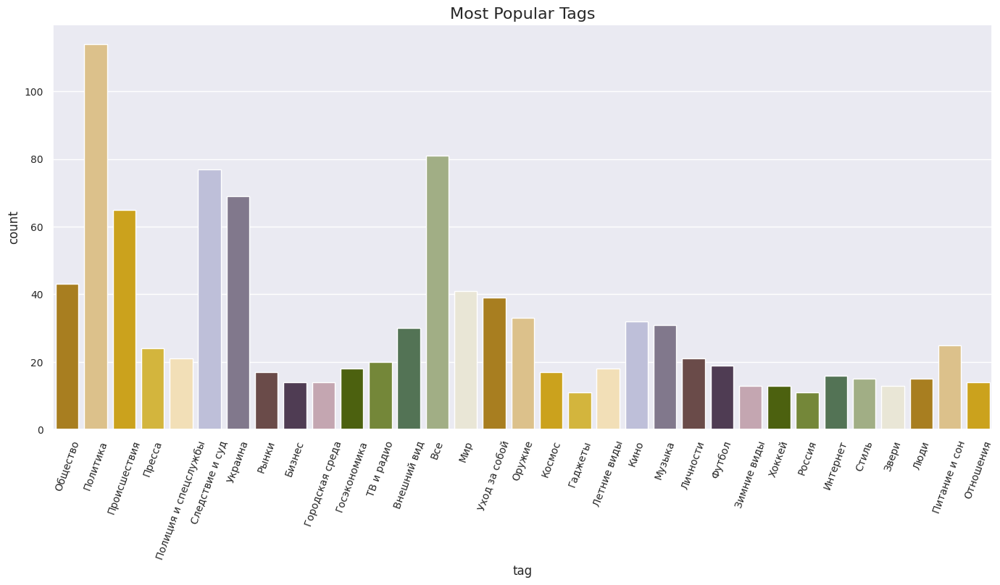

In [ ]:
tag_counts = df['tag'].value_counts()
popular_tags = tag_counts[tag_counts > 10].index
df_filtered_tags = df[df['tag'].isin(popular_tags)]

plt.figure(figsize=(14, 8))

sns.countplot(
    data=df_filtered_tags,
    x="tag",
    palette=colors
)

plt.xticks(rotation=70, fontsize=10)
plt.yticks(fontsize=10)

plt.tight_layout()

plt.title("Most Popular Tags", fontsize=16)

plt.show()


Самые многочисленные теги - Политика, Все, Следствие и суд, Украина

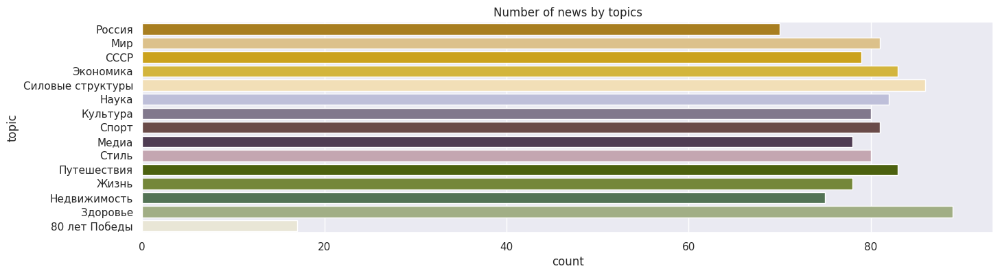

In [ ]:
fig, ax = plt.subplots(1, 1, sharex=True, sharey=True, figsize=(16, 4))
sns.countplot(y=df["topic"], ax=ax, hue_order=None, dodge=False, hue=df['topic'], palette=colors)
plt.title('Number of news by topics', fontsize=12)
plt.show()

#### 2. Author

Посмотрим на авторов и на темы, на которые они пишут

In [ ]:
df['author'].value_counts()

,count
author,
Карина Черных,39
Марина Совина,38
Дарья Коршунова,38
Мария Черкасова,37
Варвара Кошечкина,33
...,...
Константин Паршин,1
Мария Грушко,1
Юрий Леонов,1


Посмотрим на самых продуктивных авторов

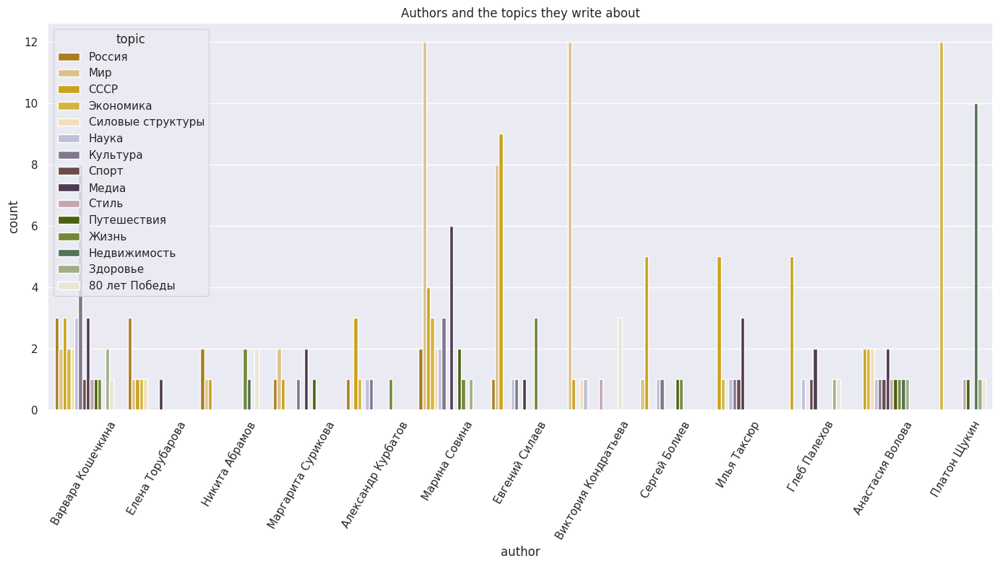

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

authors_multiple_topics = df.groupby('author')['topic'].nunique()
authors_multiple_topics = authors_multiple_topics[authors_multiple_topics > 5].index
df_filtered = df[df['author'].isin(authors_multiple_topics)]
plt.figure(figsize=(14, 8))

sns.countplot(
    data=df_filtered,
    x="author",
    hue="topic",
    palette=colors,
    dodge=True
)

plt.xticks(rotation=60)
plt.title("Authors and the topics they write about")
plt.tight_layout()

# Показать график
plt.show()


Интересно, что в основном авторы пишут на разные темы

Тем не менее, можно выделить авторов, которые пишут на определенные темы
- Платон Щукин - Мир, Экономика и Недвижимость
- Марина Совина, Виктория Кондратьева - Мир
- Евгений Силаев - Мир, СССР
- Варвара Кошечкина Культура

#### 3. Date

Сама по себе дата как строка не является признаком, однако ее компоненты могут играть важную роль в работе модели. Поэтому мы преобразуем строковую дату в формат datetime и добавим к нашим признакам год, месяц и день недели, а также час написания новости.

In [ ]:
from datetime import datetime


months = {
    "января": 1, "февраля": 2, "марта": 3, "апреля": 4,
    "мая": 5, "июня": 6, "июля": 7, "августа": 8,
    "сентября": 9, "октября": 10, "ноября": 11, "декабря": 12
}

# Функция для парсинга
def parse_date(date_str):
    time_str, date_str = date_str.split(", ")
    day, month_str, year = date_str.split(" ")
    month = months[month_str]
    time = datetime.strptime(time_str, "%H:%M").time()
    date = datetime(year=int(year), month=int(month), day=int(day)).date()
    return time, date.day, month, year

# Применяем функцию
df[['time', 'day', 'month', 'year']] = df['date'].apply(lambda x: pd.Series(parse_date(x)))
df.head()

,url,title,subtitle,author,content,date,tag,topic,time,day,month,year
0,https://lenta.ru//news/2025/01/28/moskvich-pot...,Москвич потерял сознание на улице и остался бе...,На западе Москвы мужчина упал на улице и остал...,Анна Щербакова,На западе Москвы мужчина потерял сознание и уп...,"13:53, 28 января 2025",Общество,Россия,13:53:00,28,1,2025
1,https://lenta.ru//news/2025/01/28/gosduma-razr...,Госдума разрешила оформлять ДТП по-новому,"Госдума приняла закон, разрешающий оформлять Д...",Константин Лысяков,Госдума сразу во втором и третьем чтениях прин...,"13:41, 28 января 2025",Политика,Россия,13:41:00,28,1,2025
2,https://lenta.ru//news/2025/01/28/pod-moskvoy-...,Под Москвой бойца СВО с медалями не пустили в ...,"В Подмосковье бойца СВО не пустили в бар, сосл...",Алан Босиков,В Подмосковье участника специальной военной оп...,"13:37, 28 января 2025",Общество,Россия,13:37:00,28,1,2025
3,https://lenta.ru//news/2025/01/28/v-rossii-vys...,В России высказались о плане Зеленского погово...,Депутат Журова: План Зеленского поговорить с Т...,Варвара Кошечкина,План президента Украины Владимира Зеленского п...,"13:27, 28 января 2025",Политика,Россия,13:27:00,28,1,2025
4,https://lenta.ru//news/2025/01/28/v-krymu-povy...,В Крыму повысили выплату за участие в СВО,В Крыму увеличили размер выплаты для новобранц...,Алан Босиков,В Крыму повысили выплату новобранцам специальн...,"13:21, 28 января 2025",Общество,Россия,13:21:00,28,1,2025


In [ ]:
df = df.drop('date', axis=1)
df.head()

,url,title,subtitle,author,content,tag,topic,time,day,month,year
0,https://lenta.ru//news/2025/01/28/moskvich-pot...,Москвич потерял сознание на улице и остался бе...,На западе Москвы мужчина упал на улице и остал...,Анна Щербакова,На западе Москвы мужчина потерял сознание и уп...,Общество,Россия,13:53:00,28,1,2025
1,https://lenta.ru//news/2025/01/28/gosduma-razr...,Госдума разрешила оформлять ДТП по-новому,"Госдума приняла закон, разрешающий оформлять Д...",Константин Лысяков,Госдума сразу во втором и третьем чтениях прин...,Политика,Россия,13:41:00,28,1,2025
2,https://lenta.ru//news/2025/01/28/pod-moskvoy-...,Под Москвой бойца СВО с медалями не пустили в ...,"В Подмосковье бойца СВО не пустили в бар, сосл...",Алан Босиков,В Подмосковье участника специальной военной оп...,Общество,Россия,13:37:00,28,1,2025
3,https://lenta.ru//news/2025/01/28/v-rossii-vys...,В России высказались о плане Зеленского погово...,Депутат Журова: План Зеленского поговорить с Т...,Варвара Кошечкина,План президента Украины Владимира Зеленского п...,Политика,Россия,13:27:00,28,1,2025
4,https://lenta.ru//news/2025/01/28/v-krymu-povy...,В Крыму повысили выплату за участие в СВО,В Крыму увеличили размер выплаты для новобранц...,Алан Босиков,В Крыму повысили выплату новобранцам специальн...,Общество,Россия,13:21:00,28,1,2025


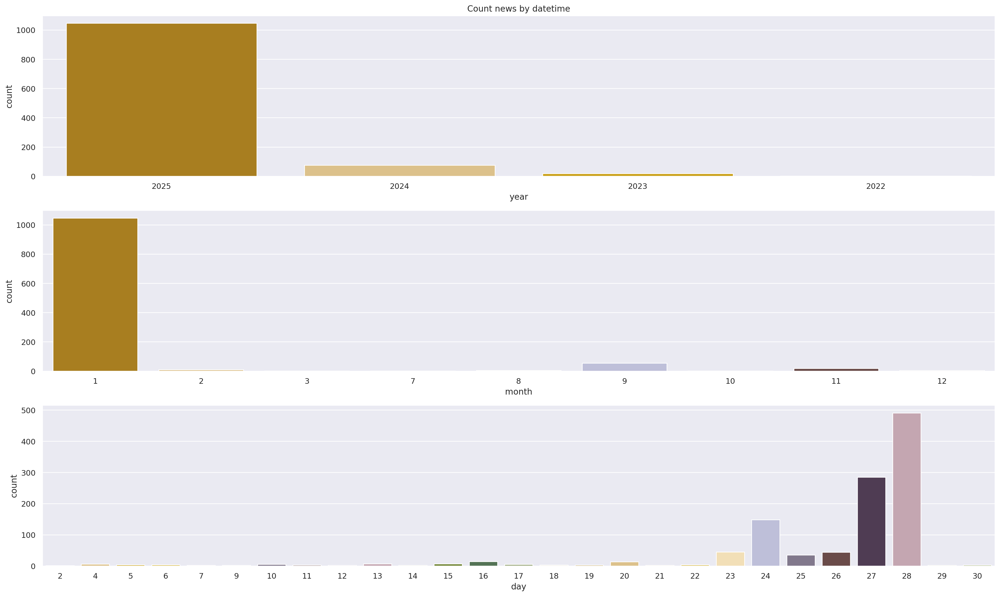

In [ ]:
fig, axs = plt.subplots(3, 1, figsize=(20, 12), dpi=200)

for ind, col in enumerate(['year', 'month', 'day']):
    sns.countplot(
        x=df[col],
        hue=df[col],
        palette=colors,
        ax=axs[ind]
    )
    # Убираем легенду
    axs[ind].legend().set_visible(False)

axs[0].set_title('Count news by datetime')
plt.tight_layout()
plt.show()

В целом, логично, что большинство новостей за 28.01.2025, так как лента обновляется часто и в день появляется много новостей на каждую из тем. Интересно, что есть новости за 2022, можно даже для интереса посмотреть на них

In [ ]:
df[df['year'] == '2022']

,url,title,subtitle,author,content,tag,topic,time,day,month,year
398,https://lenta.ru//news/2022/09/21/nadeem/,Убегавшего от наряда полиции россиянина осудил...,Убегавшего от наряда полиции жителя ЯНАО осуди...,Леонид Микуляк,Жителя Надыма (ЯНАО) осудили за пинок полицейс...,Следствие и суд,Силовые структуры,19:53:00,21,9,2022
1124,https://lenta.ru//news/2022/07/22/phone/,Психолог назвала способ отучить ребенка от тел...,"Психолог Фокина: дети «утыкаются» в телефон, п...",Елена Матвиенко,"Дети «утыкаются» в телефон, потому что им не х...",Ментальное здоровье,Здоровье,12:46:00,22,7,2022


Вроде ничего подозрительного

Посмотрим распределение по времени, но сначала отбросим минуты

In [ ]:
df['hour'] = df['time'].apply(lambda x: x.hour)

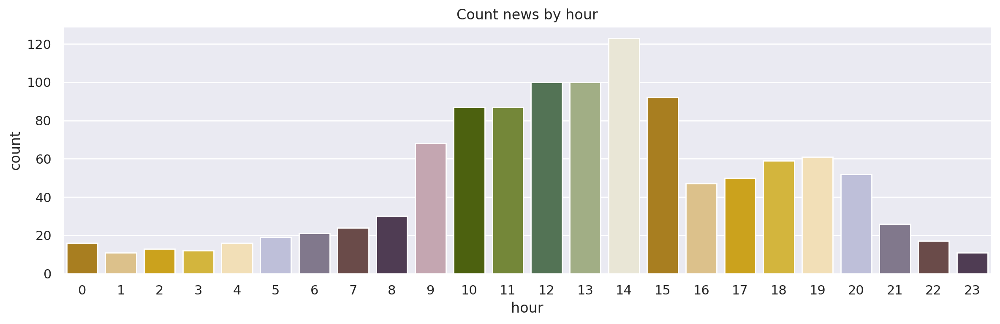

In [ ]:
plt.figure(figsize=(12, 4), dpi=200)

sns.countplot(
    x=df['hour'],
    hue=df['hour'],
    palette=colors
)

plt.legend().set_visible(False)
plt.title('Count news by hour')
plt.tight_layout()
plt.show()

Большинство новостей публикуется в рабочее время с 9 до 20

#### 4. Title, subtitle, content

Посчитаем длину заголовков и основного текста.

In [ ]:
df['len_title'] = df['title'].str.len()
df['len_subtitle'] = df['subtitle'].str.len()
df['len_content'] = df['content'].str.len()

Посмотрим, как они выглядят в разрезе каждой категории.

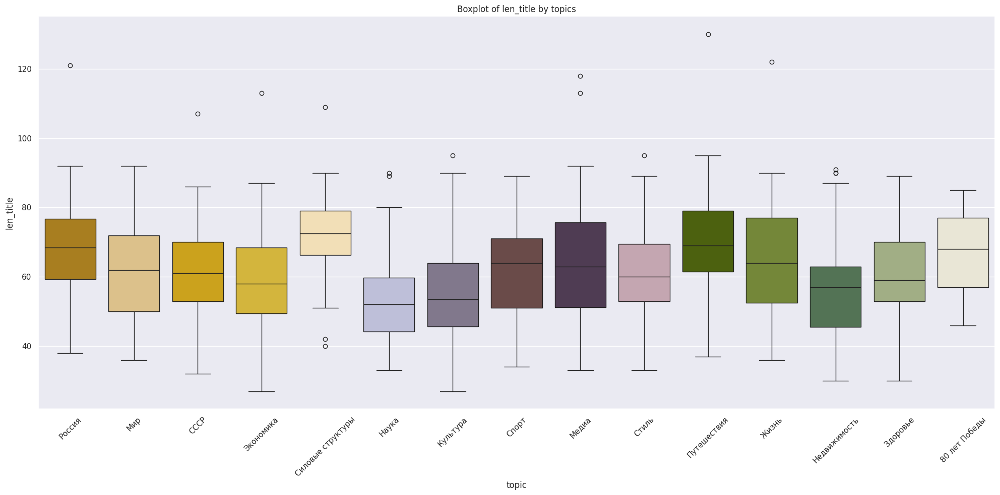

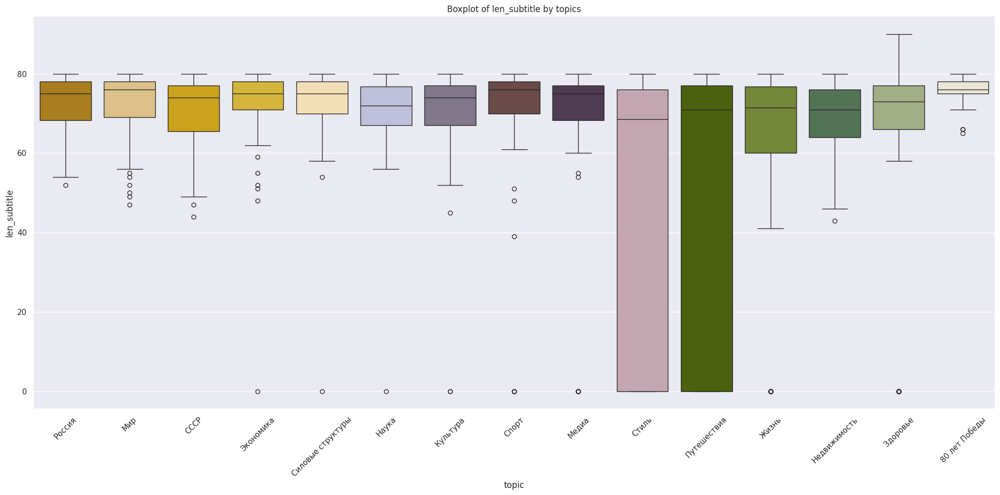

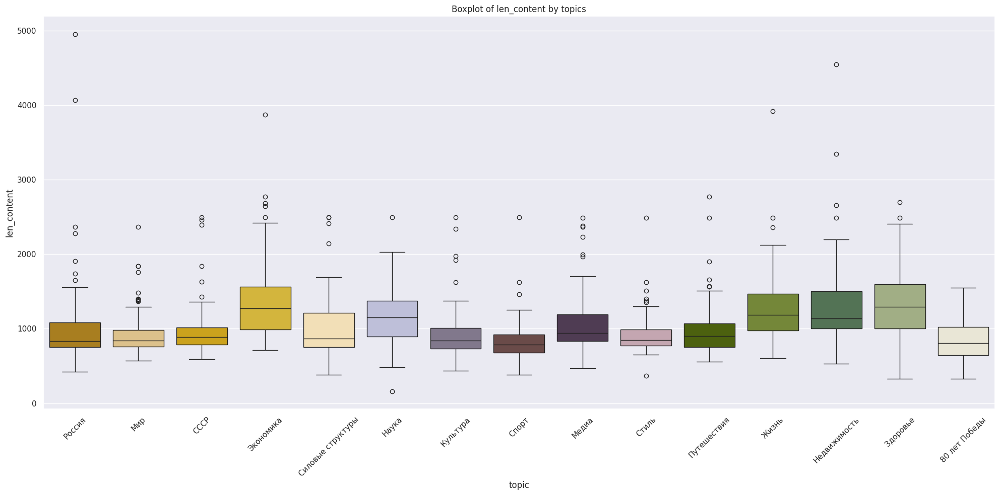

In [ ]:
for col in ['len_title', 'len_subtitle', 'len_content']:
    fig, ax = plt.subplots(1, 1, figsize=(20, 10), dpi=100)
    sns.boxplot(x="topic", y=col, data=df, ax=ax, hue='topic', palette=colors)

    plt.xticks(rotation=45)

    plt.title(f'Boxplot of {col} by topics')
    plt.tight_layout()
    plt.show()


Что можно заметить:
- В среднем длина заголовка по всем категориям около 60 символов, но категория Силовые структуры в среднем имеет более длинный заголовок > 70
- Длина подзаголовка в среднем около 70 символов, у категорий Стиль и Путешествия иногда подзаголовок отсутствует
- В среднем длина новости - около 100 символов, но это очень примерное обобщение, потому что распределение имеет тяжелые хвосты и много выбросов
- Особенно хвосты выражены по категориям: Экономика, Здоровье, Недвижимость, Наука, Жизнь

#### 5. Keywords

Посмотрим, какие ключевые слова чаще всего встречаются в статьях каждой тематики. Одной из гипотез является то, что статьи разных, но при этом близких тематик с одинаковыми ключевыми словами могут вносить негативный вклад в работу модели.

In [ ]:
stop_words = stopwords.words('russian')
stop_words.extend(['что', 'это', 'так',
                    'вот', 'быть', 'как',
                    'в', '—', 'к', 'за', 'из', 'из-за',
                    'на', 'ок', 'кстати',
                    'который', 'мочь', 'весь',
                    'еще', 'также', 'свой',
                    'ещё', 'самый', 'ул', 'комментарий',
                    'английский', 'язык'])

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

cmap = LinearSegmentedColormap.from_list("custom_cmap", colors)

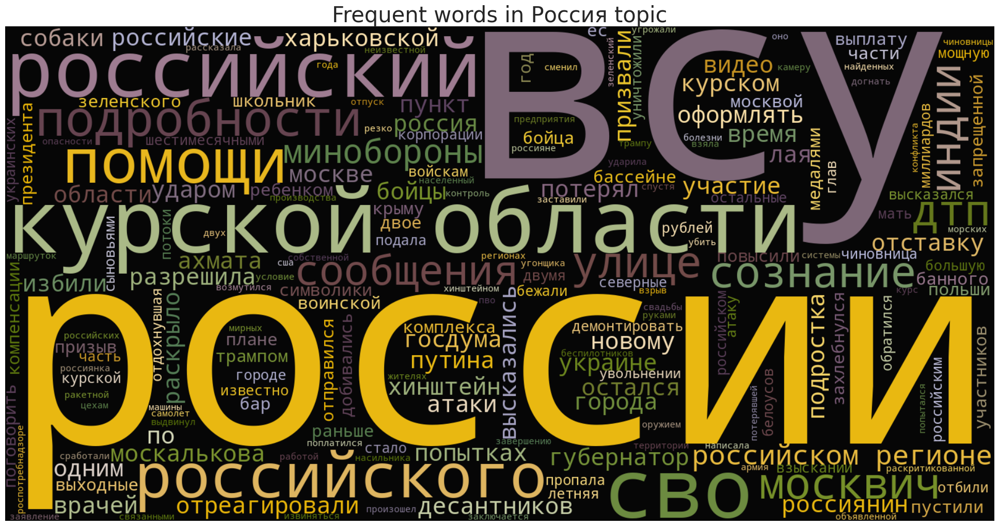

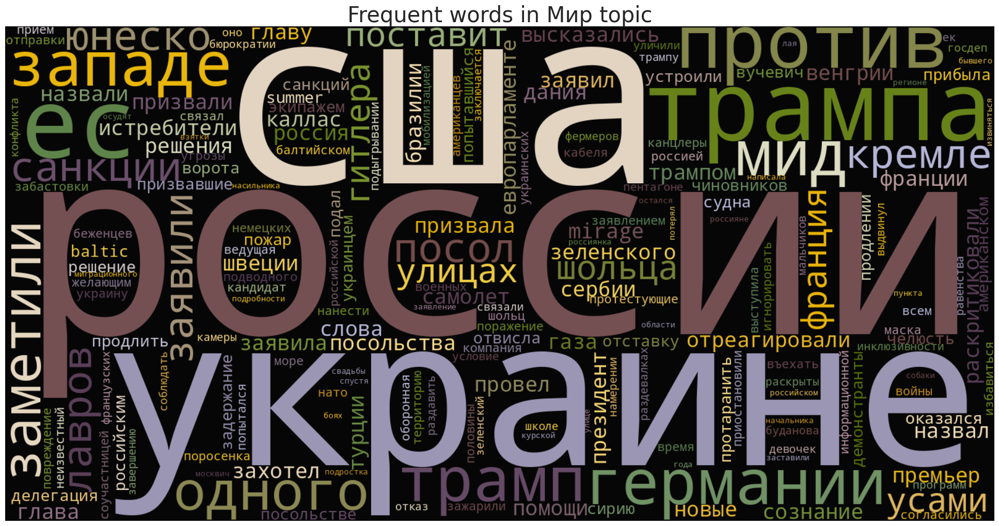

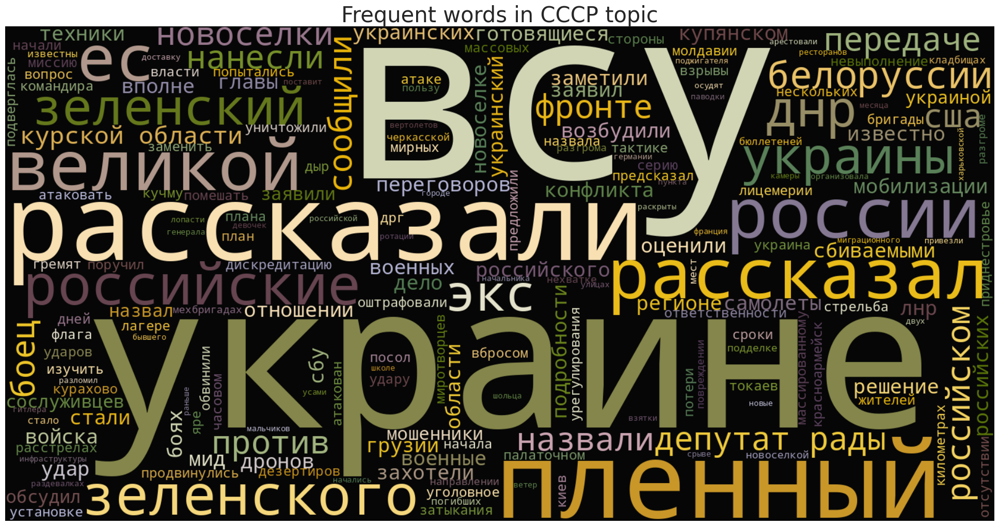

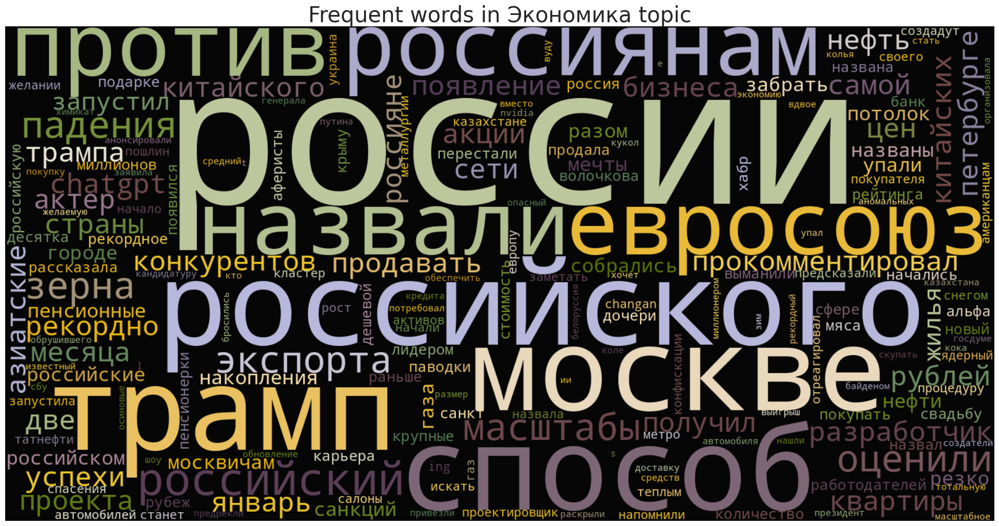

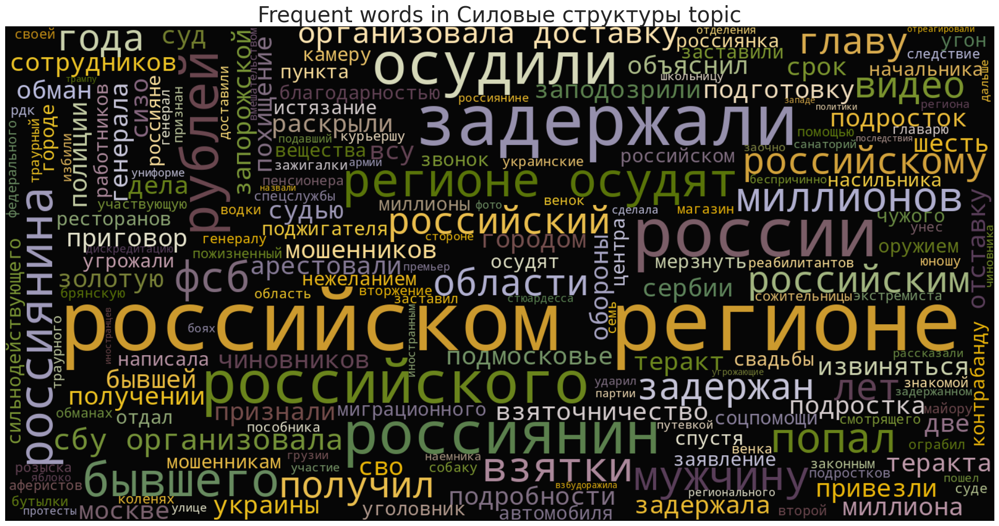

...

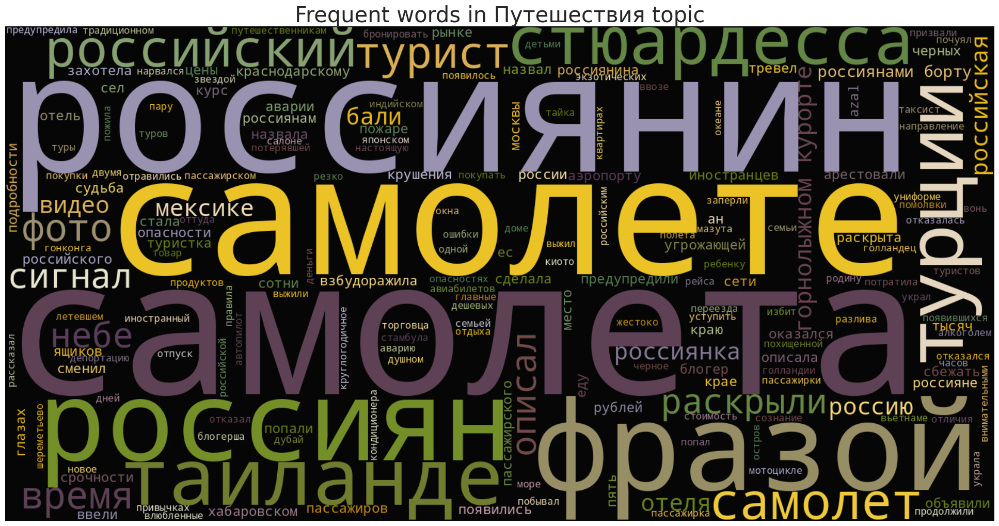

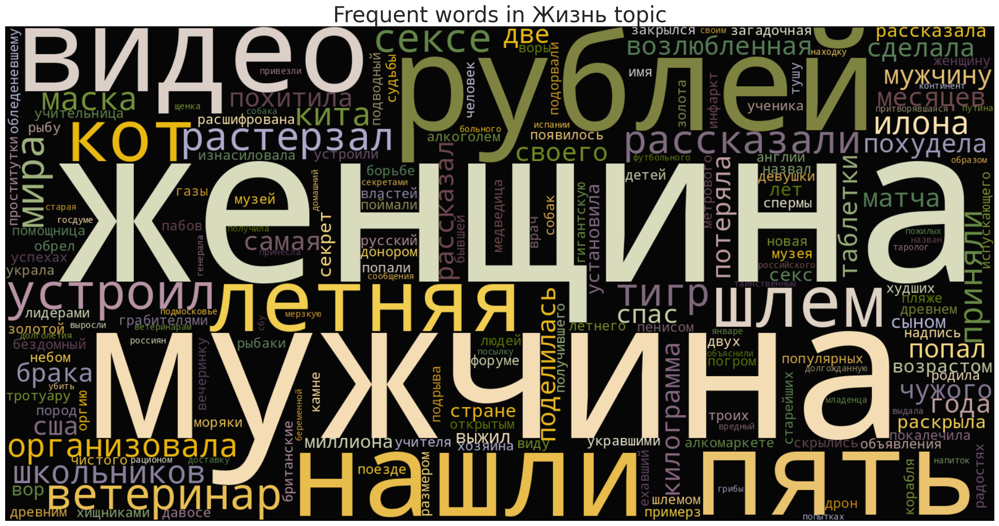

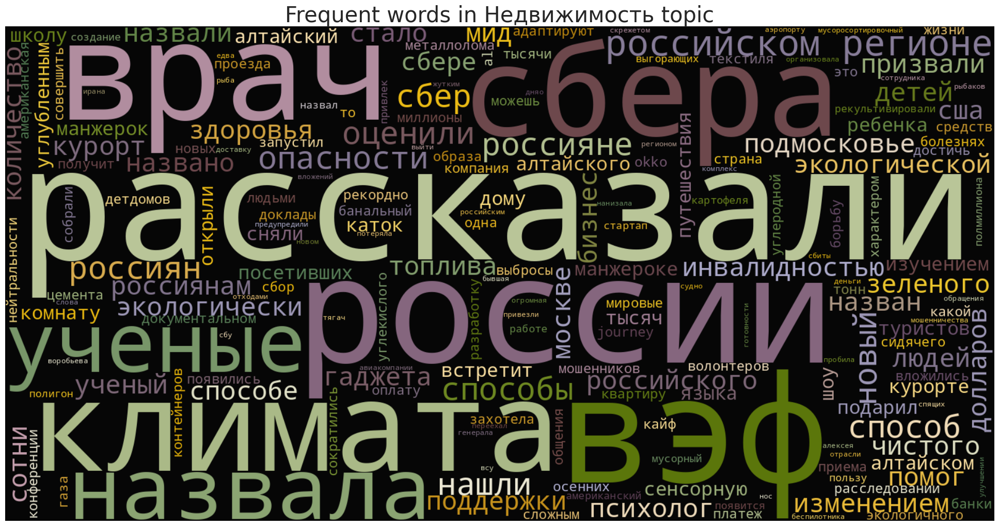

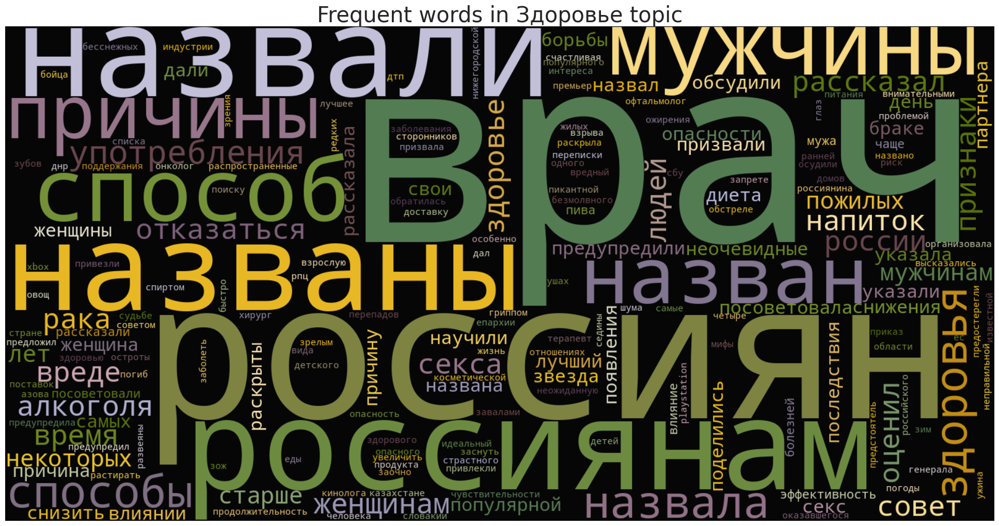

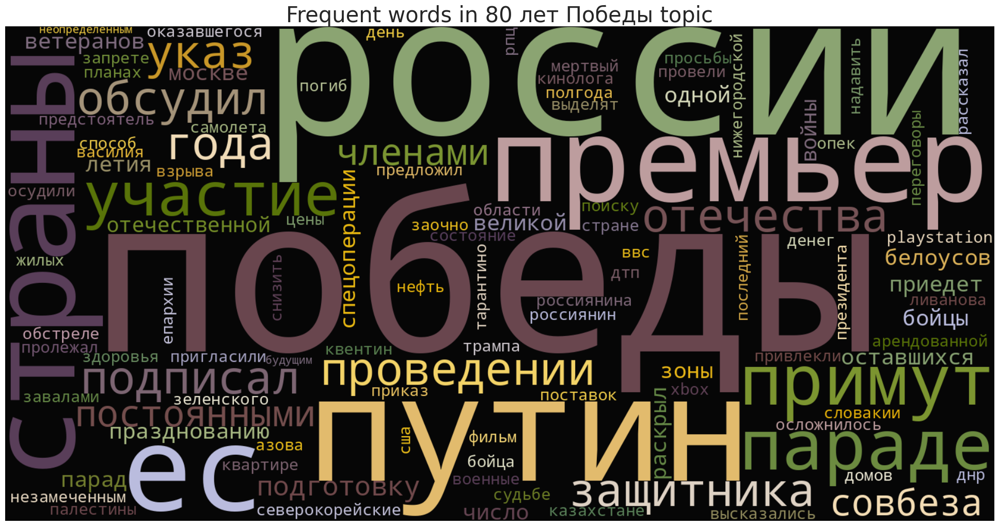

In [ ]:
for topic in df.topic.unique():
    words = df[df.topic == topic].title.str.split(' ').explode().values
    words = [word.lower() for word in words if word.lower() not in stop_words]

    wc = WordCloud(
        background_color="black",
        width=1600,
        height=800,
        max_words=200,
        contour_color='white',
        contour_width=1,
        colormap=cmap
    ).generate(" ".join(words))

    # Отображение облака слов
    fig, ax = plt.subplots(1, 1, figsize=(20, 10))
    plt.axis("off")  # Убираем оси
    ax.set_title(f"Frequent words in {topic} topic", fontsize=30)
    ax.imshow(wc, interpolation='bilinear', alpha=0.98)  # Используем bilinear для улучшенной визуализации
    plt.tight_layout(pad=0)
    plt.show()


Облака слов выглядят очень красиво и их интересно рассматривать, но по ним сложно сказать что-то конертное, кроме того, что они в целом отражают содержание тем, а также, что некоторые слова являются характерными для сразу нескольких категорий, что может усложнить обучение модели

### Выводы

Итак, на данном этапе мы провели первичный анализ датасета. Статьи распределены по тематикам достаточно равномерно. Почти все новости относятся к 28.01.2025, потому что в этот день проводился парсинг, а Лента.ру подразумевает поток новостей. Инетересно было бы провести цикл парсинга в течении некоторого времени, чтобы посмотреть как распределяется выход новостей по дням недели.

В среднем длина заголовка по всем категориям около 60 символов. Длина текста варьируется, в среднем около 1000 символов, но распределение имеет тяжелые хвосты и множественные выбросы.

Были проанализированы основные ключевые слова, которые наводят на гипотезу о том, что статьи разных тематик могут быть сильно похожи по доминирующим ключевым словам и тем самым негативно влиять на модель. Это нужно будет иметь в виду при построоении модели.

Поскольку мы работаем с текстами, на этом этапе пока не столь очевидно, какие данные и по какой причине стоит считать выбросами, а какие - особенностями конкретной тематики. Поэтому это мы оставим на следующие этапы работы над проектом.

## Часть 2

Приступим к подготовке к работе с моделью

Еще раз подгрузим наш датасет, особо я никак не буду обрабатывать колонки никак, потому что хочу попробовать обучить модель только на текстах, и, может, еще на заголовках новостей

In [ ]:
import pandas as pd

df = pd.read_csv('/content/articles.csv', index_col=None)
df.head()

,url,title,subtitle,author,content,date,tag,topic
0,https://lenta.ru//news/2025/01/28/moskvich-pot...,Москвич потерял сознание на улице и остался бе...,На западе Москвы мужчина упал на улице и остал...,Анна Щербакова,На западе Москвы мужчина потерял сознание и уп...,"13:53, 28 января 2025",Общество,rubrics/russia
1,https://lenta.ru//news/2025/01/28/gosduma-razr...,Госдума разрешила оформлять ДТП по-новому,"Госдума приняла закон, разрешающий оформлять Д...",Константин Лысяков,Госдума сразу во втором и третьем чтениях прин...,"13:41, 28 января 2025",Политика,rubrics/russia
2,https://lenta.ru//news/2025/01/28/pod-moskvoy-...,Под Москвой бойца СВО с медалями не пустили в ...,"В Подмосковье бойца СВО не пустили в бар, сосл...",Алан Босиков,В Подмосковье участника специальной военной оп...,"13:37, 28 января 2025",Общество,rubrics/russia
3,https://lenta.ru//news/2025/01/28/v-rossii-vys...,В России высказались о плане Зеленского погово...,Депутат Журова: План Зеленского поговорить с Т...,Варвара Кошечкина,План президента Украины Владимира Зеленского п...,"13:27, 28 января 2025",Политика,rubrics/russia
4,https://lenta.ru//news/2025/01/28/v-krymu-povy...,В Крыму повысили выплату за участие в СВО,В Крыму увеличили размер выплаты для новобранц...,Алан Босиков,В Крыму повысили выплату новобранцам специальн...,"13:21, 28 января 2025",Общество,rubrics/russia


In [ ]:
category_mapping = {
    "rubrics/wellness": "wellness",
    "rubrics/forces": "forces",
    "rubrics/economics": "economics",
    "rubrics/travel": "travel",
    "rubrics/science": "science",
    "rubrics/sport": "sport",
    "rubrics/world": "world",
    "rubrics/style": "style",
    "rubrics/ussr": "ussr",
    "rubrics/culture": "culture",
    "rubrics/media": "media",
    "rubrics/life": "life",
    "rubrics/realty": "realty",
    "rubrics/russia": "russia",
    "rubrics/pobeda80": "pobeda80"
}

df["topic"] = df["topic"].map(category_mapping)

In [ ]:
df.head()

,url,title,subtitle,author,content,date,tag,topic
0,https://lenta.ru//news/2025/01/28/moskvich-pot...,Москвич потерял сознание на улице и остался бе...,На западе Москвы мужчина упал на улице и остал...,Анна Щербакова,На западе Москвы мужчина потерял сознание и уп...,"13:53, 28 января 2025",Общество,russia
1,https://lenta.ru//news/2025/01/28/gosduma-razr...,Госдума разрешила оформлять ДТП по-новому,"Госдума приняла закон, разрешающий оформлять Д...",Константин Лысяков,Госдума сразу во втором и третьем чтениях прин...,"13:41, 28 января 2025",Политика,russia
2,https://lenta.ru//news/2025/01/28/pod-moskvoy-...,Под Москвой бойца СВО с медалями не пустили в ...,"В Подмосковье бойца СВО не пустили в бар, сосл...",Алан Босиков,В Подмосковье участника специальной военной оп...,"13:37, 28 января 2025",Общество,russia
3,https://lenta.ru//news/2025/01/28/v-rossii-vys...,В России высказались о плане Зеленского погово...,Депутат Журова: План Зеленского поговорить с Т...,Варвара Кошечкина,План президента Украины Владимира Зеленского п...,"13:27, 28 января 2025",Политика,russia
4,https://lenta.ru//news/2025/01/28/v-krymu-povy...,В Крыму повысили выплату за участие в СВО,В Крыму увеличили размер выплаты для новобранц...,Алан Босиков,В Крыму повысили выплату новобранцам специальн...,"13:21, 28 января 2025",Общество,russia


In [ ]:
!pip install natasha

In [ ]:
from collections import defaultdict
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import SVC

import gensim.downloader
from gensim.models import Word2Vec, KeyedVectors
from natasha import Doc, Segmenter, MorphVocab, NewsEmbedding, NewsMorphTagger

import mlxtend
from mlxtend.evaluate import paired_ttest_kfold_cv

from plotly.offline import iplot
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import datetime
from wordcloud import WordCloud, STOPWORDS

import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")

sns.set(style="darkgrid")
%matplotlib inline

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
colors = [
    "#BF8709", "#EAC57D", "#E8B100", "#ECC424", "#FCE2AD",
    "#B9BBDE", "#807490", "#704643", "#523857", "#C9A1B0",
    "#536F01", "#7A942C", "#4E7850", "#A3B57E", "#ECE8D3"
]

sns.set_palette(sns.color_palette(colors))

In [ ]:
RND_STATE = 42

Чтобы получить более точное и компактное представление текстов, обычно делают нормализацию текста, которая включает в себя следующие этапы:
- lowering
- tokenize
- lemmatize
- remove symbols
- remove stop-words

Для нас совершенно не важен регистр текста, его род и падеж, а также различные символы, которые и вовсе текстом не являются.

Таким образом, мы ожидаем, что после предобработки текста качество модели должно возрасти.

Существуют разные библиотеки для обработки текста, мы будем использовать Наташу, потому что она включяет в себя все необходимые нам элементы предобработки (токенизация и лемматизация), а также [демонстрирует сравнительно хорошее качество](https://github.com/natasha/naeval) при работе с русским языком.

In [ ]:
stop_words = stopwords.words('russian')
stop_words.extend(['что', 'это', 'так',
                    'вот', 'быть', 'как',
                    'в', '—', 'к', 'за', 'из', 'из-за',
                    'на', 'ок', 'кстати',
                    'который', 'мочь', 'весь',
                    'еще', 'также', 'свой',
                    'ещё', 'самый', 'ул', 'комментарий',
                    'английский', 'язык'])

#### 1. Natasha

In [ ]:
segmenter = Segmenter()
morph_vocab = MorphVocab()
emb = NewsEmbedding()
morph_tagger = NewsMorphTagger(emb)

In [ ]:
def text_prep(text) -> str:
    doc = Doc(text)
    doc.segment(segmenter)
    doc.tag_morph(morph_tagger)

    for token in doc.tokens:
        token.lemmatize(morph_vocab)

    lemmas = [_.lemma for _ in doc.tokens]
    words = [lemma for lemma in lemmas if lemma.isalpha() and len(lemma) > 2]
    filtered_words = [word for word in words if word not in stop_words]
    return " ".join(filtered_words)

In [ ]:
%%time
df['title_clean'] = df['title'].apply(text_prep)

CPU times: user 11.8 s, sys: 49.9 s, total: 1min 1s
Wall time: 6.39 s


In [ ]:
%%time
df['content_clean'] = df['content'].apply(text_prep)

CPU times: user 1min 26s, sys: 4min 44s, total: 6min 10s
Wall time: 35.4 s


In [ ]:
df['content_clean'][0]

'запад москва мужчина потерять сознание упасть улица горожанин остаться помощь поскольку собака начать лаять пытаться приблизиться хозяин сообщить издание baza прохожий заметить лежать земля мужчина возле продуктовый магазин новорублевский улица предположительно несчастный рухнуть дерево суметь подняться самостоятельно очевидец захотеть подойти горожанин встретить лаять пес животное улечься рядом пострадать писать baza собака отказываться подпускать владелец житель столица вызвать место врач сотрудник мчс стать известный возбудить дело отношение мужчина избить собака сожительница информация состояние пострадать животное приводиться'

In [ ]:
# Заголовок
df.sample(1)[['title', 'title_clean']].values

array([['В Грузии перечислили красные линии',
        'грузия перечислить красный линия']], dtype=object)

In [ ]:
# Содержание
df.sample(1)[['content', 'content_clean']].values

array([['Бронзовый призер Олимпийских игр по лыжным гонкам Анастасия Кулешова пожаловалась на маленькую зарплату в сборной Нижегородской области, которую она представляет на всероссийских соревнованиях. Ее слова приводит «Спорт-Экспресс». По словам спортсменки, ей предлагали выступать за другой регион, но она отказалась. «Я не могу оттуда уйти, потому что это мой родной регион, там мои родители, тренеры. Не могу чисто по каким-то моральным принципам поменять команду», — заявила Кулешова. Ранее двукратный олимпийский чемпион по плаванию Евгений Рылов рассказал о том, как международное отстранение повлияло на его доходы. Спортсмен отметил, что он не заметил большой разницы. Кулешова взяла бронзу в эстафете на Олимпиаде 2018 года в Пхенчхане. Она также стала третьей в этом же виде программы на ЧМ-2019.',
        'бронзовый призер олимпийский игра лыжный гонка анастасия кулешов пожаловаться маленький зарплата сборная нижегородский область представлять всероссийский соревнование слово приво

Выглядит неплохо

#### 2. FastText

Возмем уже обученную модель

In [ ]:
!pip install fasttext

In [ ]:
import fasttext.util

# Загружаем модель
fasttext.util.download_model('ru', if_exists='ignore')
ft = fasttext.load_model('cc.ru.300.bin')

In [ ]:
import numpy as np

def text_to_vector(text, model):
    words = text.split()  # Разбиваем текст на слова
    word_vectors = [model.get_word_vector(word) for word in words if word in model]
    if not word_vectors:
        return np.zeros(model.get_dimension())  # Если слов нет, возвращаем нули
    return np.mean(word_vectors, axis=0)  # Усредняем


In [ ]:
df['title_vector'] = df['title_clean'].apply(lambda x: text_to_vector(x, ft))
df['content_vector'] = df['content_clean'].apply(lambda x: text_to_vector(x, ft))

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(df['title_vector'].tolist(), df['topic'], test_size=0.2, random_state=42)

In [ ]:
clf = LogisticRegression(max_iter=1000, random_state=42)
clf.fit(X_train, y_train)

LogisticRegression(max_iter=1000, random_state=42)

In [ ]:
y_pred = clf.predict(X_test)

# Classification report
print("Classification Report:")
print(classification_report(y_test, y_pred, zero_division=1))

Classification Report:
              precision    recall  f1-score   support

     culture       0.62      0.42      0.50        19
   economics       0.42      0.42      0.42        19
      forces       0.52      0.60      0.56        25
        life       0.41      0.47      0.44        15
       media       0.00      0.00      0.00        10
    pobeda80       1.00      0.00      0.00         5
      realty       0.50      0.13      0.21        15
      russia       0.00      0.00      0.00        16
     science       0.67      0.59      0.62        17
       sport       0.80      0.57      0.67        14
       style       0.82      0.74      0.78        19
      travel       0.26      0.78      0.39         9
        ussr       0.33      0.38      0.36        13
    wellness       0.43      0.80      0.56        15
       world       0.44      0.67      0.53        18

    accuracy                           0.47       229
   macro avg       0.48      0.44      0.40       229
wei

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

cmap_colors = ['#FAD074', '#e18d01', '#5C6954']
cmap = LinearSegmentedColormap.from_list("custom_cmap", cmap_colors)

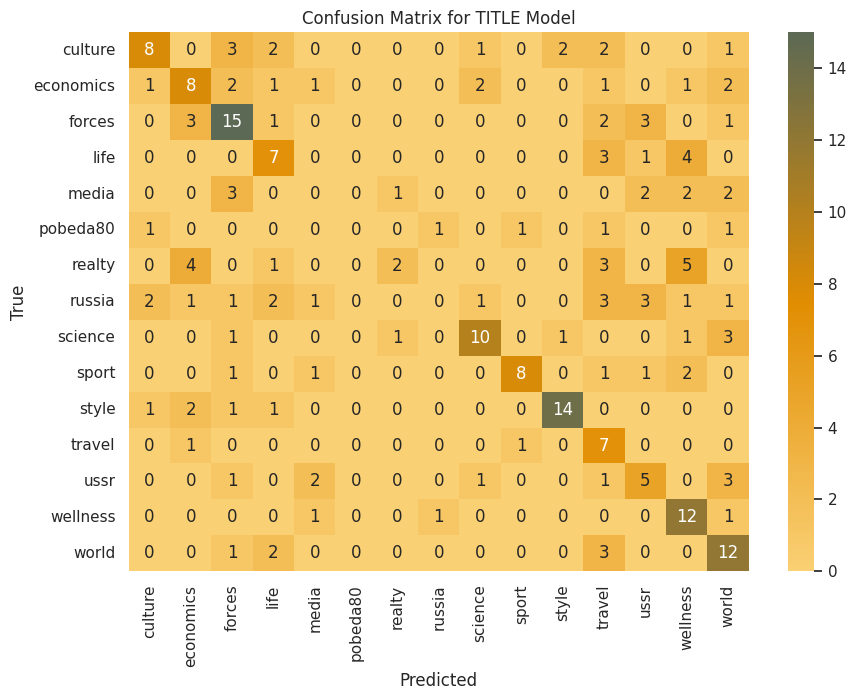

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Confusion Matrix
labels = clf.classes_
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap=cmap, xticklabels=labels, yticklabels=labels)
plt.title("Confusion Matrix for TITLE Model")
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


Ну, в целом, даже не сильно плохо, видно выраженную диагональ, но модель сильно ошибается в forces, science, sport. Спорт вообще признается всем подряд, кроме спорта. Попробую теперь то же самое, но на самом тексте новостей

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df['content_vector'].tolist(), df['topic'], test_size=0.2, random_state=42)

In [ ]:
clf = LogisticRegression(max_iter=1000, random_state=42)
clf.fit(X_train, y_train)

LogisticRegression(max_iter=1000, random_state=42)

In [ ]:
y_pred = clf.predict(X_test)

# Classification report
print("Classification Report:")
print(classification_report(y_test, y_pred, zero_division=1))

Classification Report:
              precision    recall  f1-score   support

     culture       0.75      0.47      0.58        19
   economics       0.52      0.58      0.55        19
      forces       0.62      0.72      0.67        25
        life       1.00      0.27      0.42        15
       media       0.00      0.00      0.00        10
    pobeda80       1.00      0.00      0.00         5
      realty       1.00      0.07      0.12        15
      russia       1.00      0.00      0.00        16
     science       0.86      0.71      0.77        17
       sport       0.85      0.79      0.81        14
       style       0.84      0.84      0.84        19
      travel       0.17      0.67      0.27         9
        ussr       0.28      0.38      0.32        13
    wellness       0.34      0.80      0.48        15
       world       0.42      0.61      0.50        18

    accuracy                           0.51       229
   macro avg       0.64      0.46      0.42       229
wei

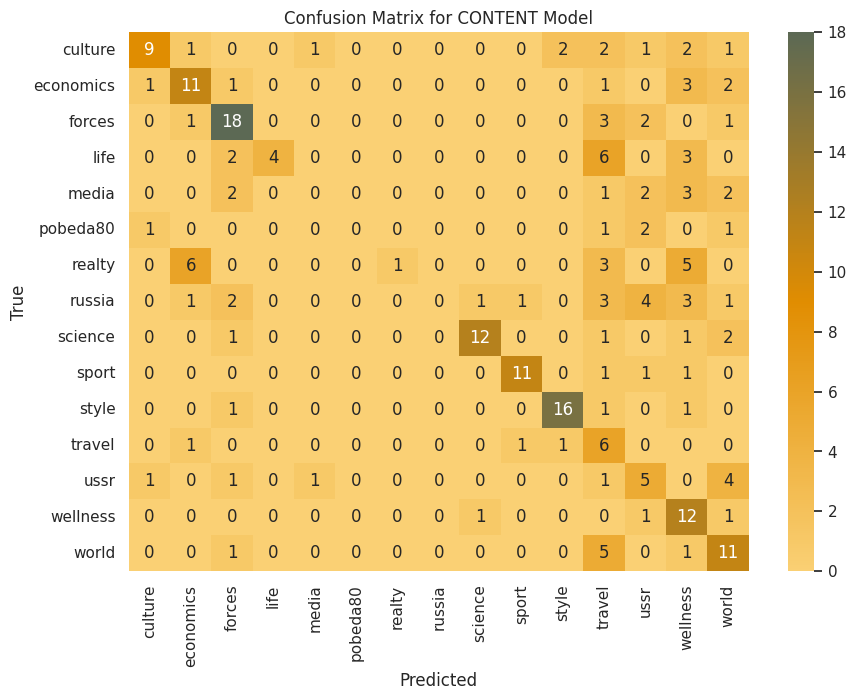

In [ ]:
# Confusion Matrix

conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap=cmap, xticklabels=clf.classes_, yticklabels=clf.classes_)
plt.title("Confusion Matrix for CONTENT Model")
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

В общем accuracy повысился, но меньше, чем я ожидала, модель продолжает ошибатся в тех же темах, что раньше. Для такого количества классов нужно что-то посложнее, как мне кажется

#### 3. RuBERT

Для руберта Наташа уже не нужна, у него свой токенизатор

In [ ]:
!pip install transformers datasets torch scikit-learn

In [ ]:
from transformers import AutoTokenizer, AutoModel
import torch

# Загружаем токенизатор и модель
model_name = "DeepPavlov/rubert-base-cased"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning:


The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.



tokenizer_config.json:   0%|          | 0.00/24.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/1.65M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/714M [00:00<?, ?B/s]

Some weights of the model checkpoint at DeepPavlov/rubert-base-cased were not used when initializing BertModel: ['cls.predictions.bias', 'cls.predictions.decoder.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
def get_bert_embedding(text):
    """Функция для получения эмбеддинга текста с помощью RuBERT"""
    tokens = tokenizer(text, padding='max_length', truncation=True, max_length=512, return_tensors="pt")
    with torch.no_grad():  # Выключаем градиенты, т.к. обучение не нужно
        output = model(**tokens)
    return output.last_hidden_state[:, 0, :].squeeze().numpy()  # Берём [CLS] токен

In [ ]:
df["bert_vector"] = df["title"].apply(get_bert_embedding)
X = np.vstack(df["bert_vector"].values)
y = df["topic"].values

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = LogisticRegression(max_iter=1000, random_state=42)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print("Classification Report:")
print(classification_report(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

     culture       0.68      0.68      0.68        19
   economics       0.48      0.53      0.50        19
      forces       0.62      0.60      0.61        25
        life       0.43      0.60      0.50        15
       media       0.33      0.40      0.36        10
    pobeda80       0.00      0.00      0.00         5
      realty       0.53      0.60      0.56        15
      russia       0.50      0.50      0.50        16
     science       0.68      0.76      0.72        17
       sport       0.83      0.71      0.77        14
       style       0.87      0.68      0.76        19
      travel       0.40      0.44      0.42         9
        ussr       0.36      0.38      0.37        13
    wellness       0.50      0.40      0.44        15
       world       0.56      0.50      0.53        18

    accuracy                           0.56       229
   macro avg       0.52      0.52      0.52       229
wei

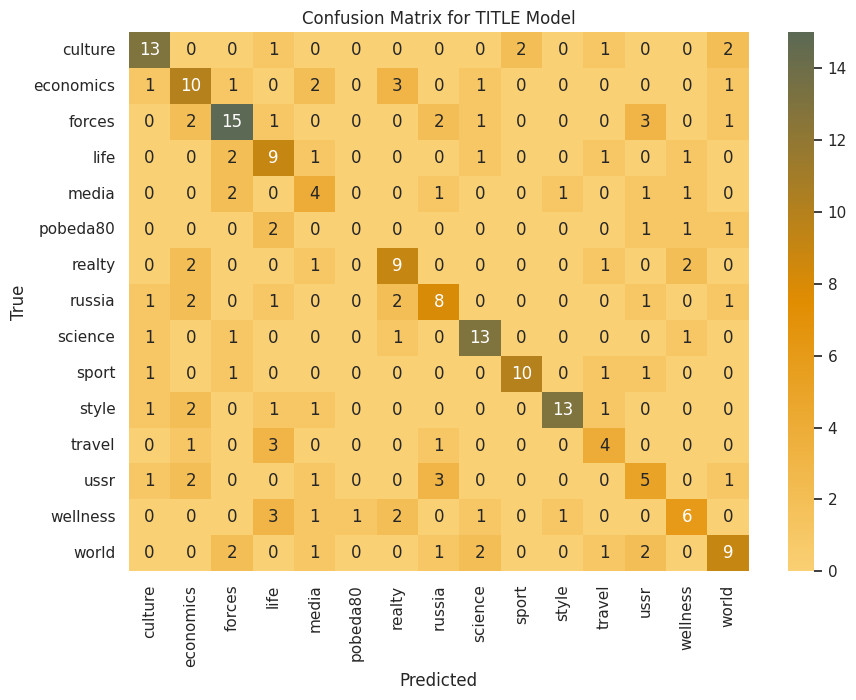

In [ ]:
# Confusion Matrix
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap=cmap, xticklabels=clf.classes_, yticklabels=clf.classes_)
plt.title("Confusion Matrix for TITLE Model")
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

Удалось еще чуть-чуть улучшить результат, теперь модель лучше различает все темы, кроме 80-летия победы

Теперь обучу на содержании статей

In [ ]:
df["bert_vector"] = df["content"].apply(get_bert_embedding)
X = np.vstack(df["bert_vector"].values)
y = df["topic"].values

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

clf = LogisticRegression(max_iter=1000, random_state=42)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)

print("Classification Report:")
print(classification_report(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

     culture       0.71      0.63      0.67        19
   economics       0.65      0.89      0.76        19
      forces       0.73      0.76      0.75        25
        life       0.75      0.80      0.77        15
       media       0.67      0.60      0.63        10
    pobeda80       1.00      0.40      0.57         5
      realty       0.79      0.73      0.76        15
      russia       0.53      0.56      0.55        16
     science       0.93      0.76      0.84        17
       sport       0.92      0.79      0.85        14
       style       1.00      0.84      0.91        19
      travel       0.47      0.78      0.58         9
        ussr       0.50      0.54      0.52        13
    wellness       0.71      0.80      0.75        15
       world       0.79      0.61      0.69        18

    accuracy                           0.72       229
   macro avg       0.74      0.70      0.71       229
wei

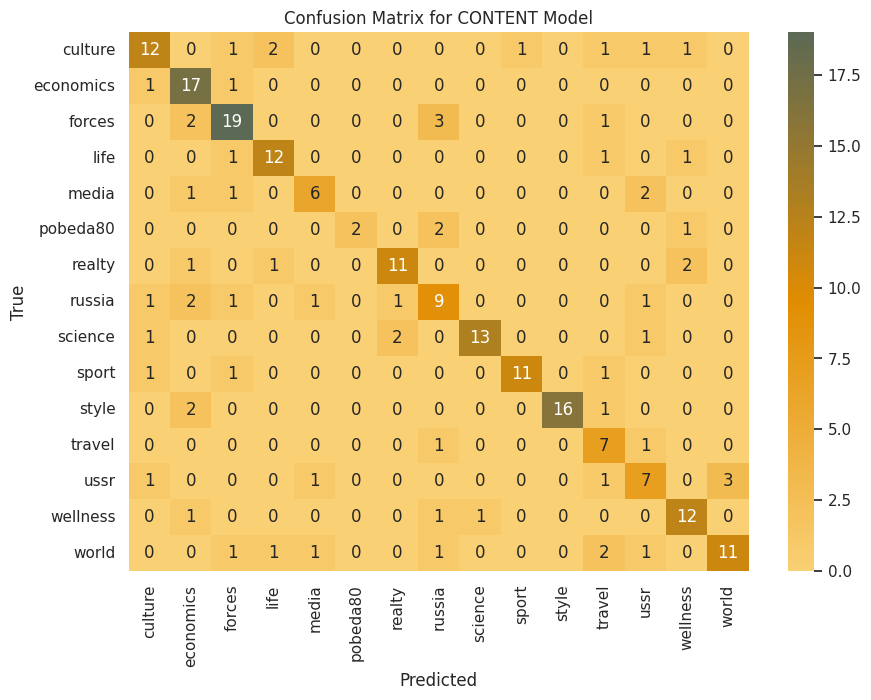

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap=cmap, xticklabels=clf.classes_, yticklabels=clf.classes_)
plt.title("Confusion Matrix for CONTENT Model")
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


Вот это уже вполне себе неплохо, accuracy 0.72, а по конфьюжн матрице можно сказать, что модель ошибается в темах, в которых вполне логично ошибаться - например life, travel, culture - сходные темы. Есть проблема с 80-летием победы, но изначально новостей по этой темы было меньше, чем остальных, может проблема в этом.

Есть идеи как улучшить результат - можно объединить текст новости с заголовком, а также я думаю чтожно взять что-то вместо логистической регрессии (например, кэтбуст), также можно учитывать и другие параметры, которые мы спарсили - автора и подзаголовок.

Как итог, даже без улучшения, я думаю результат получился неплох для такого количества не слишком простых для классификации категорий.